# PHYS6318: Lecture 5

In [3]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
from matplotlib import rcParams
rcParams['animation.html'] = 'jshtml'
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import netCDF4
import time
import os
import glob

## OMB 5.1 Long Waves in a Shallow Lake

Read OMB 5.1.1, 5.1.2, 5.1.3, 5.1.4, 5.1.8.

Note the strong similarities to the problem of long waves in a channel that we have already covered in OMB Chapter 4.

## OMB 5.2 Exercise 8: Long Waves in a Shallow Lake

### 5.2.1 Aim
The aim of this exercise is to simulate the progression of long circular surface gravity waves in a two-dimensional domain.

### 5.2.2 Task Description

We consider a square lake of 500 m× 500 m in areal extent and 10 m in depth
using equidistant lateral grid spacings of Δx = Δy = 10 m. Lateral boundaries
are closed. The flooding algorithm is included. Lake water is of uniform density.
Forcing consists of an initial sea-level elevation of 1 m in the central grid cell that,
when released, will create a tsunami-type wave spreading out in all directions. Such
waves, created by a point-source disturbance, are called *circular waves*. The time
step is chosen at Δt = 0.1 s, which satisfies the CFL stability criterion. The simulation is run for 100 s with data outputs at every 0.5 s

### 5.2.3 Sample Code and Animation Script

The model code from the folder "Exercise 8" has been modified to support NetCDF files as output. See `src/OMB_Ex8`.

When run, the program creates a file called `output.nc`. Notice that we now include **coordinates** in the NetCDF file.  If the coordinates have the same name as a the corresponding dimension, `xarray` will automatically use them.  

***Careful***:  While the coordinates are labeled $x$ and $y$ they actual only refer to the coordinates of `eta` and `h`.  The variables `u` and `v` are on a grid that is slightly staggered from the grid saved here.

In [36]:
filename = 'src/OMB_Ex8/output.nc'

In [37]:
ds = xr.open_dataset(filename)
ds

<xarray.Dataset>
Dimensions:  (time: 201, x: 51, y: 51)
Coordinates:
  * time     (time) datetime64[ns] 2000-01-01 ... 2000-01-01T00:01:40
  * x        (x) float32 12.5 22.5 32.5 42.5 52.5 ... 482.5 492.5 502.5 512.5
  * y        (y) float32 12.5 22.5 32.5 42.5 52.5 ... 482.5 492.5 502.5 512.5
Data variables:
    h        (time, x, y) float32 ...
    eta      (time, x, y) float32 ...
    u        (time, x, y) float32 ...
    v        (time, x, y) float32 ...

We can visualize this data with xarray:

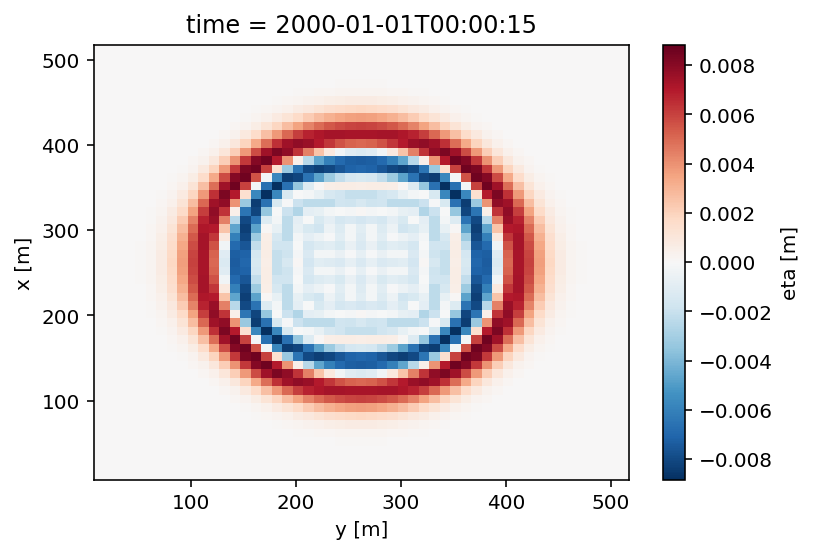

In [38]:
ds.eta[30].plot()

Or as a 3d surface:

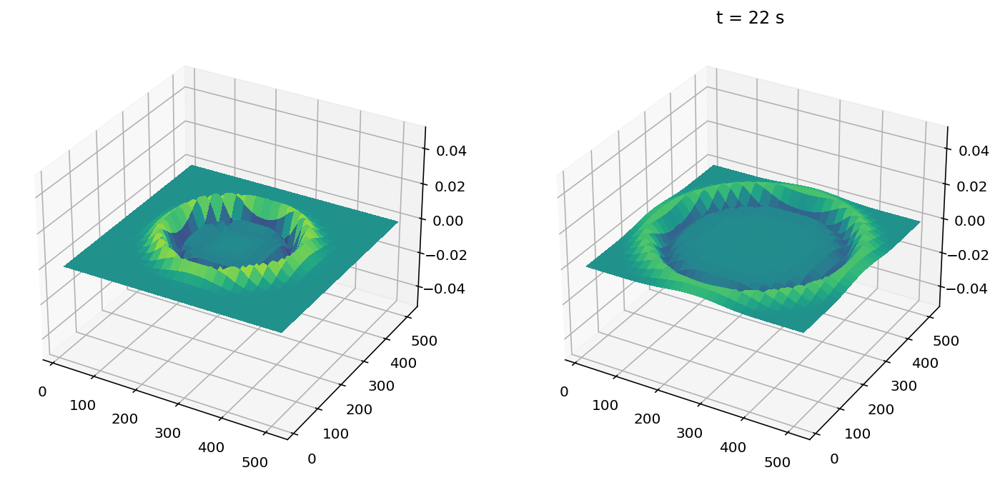

In [39]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(12,6))
ax1 = fig.add_subplot(1,2,1,projection='3d')
ax2 = fig.add_subplot(1,2,2,projection='3d')  

# Make data.
X = ds.x.values
Y = ds.y.values
X, Y = np.meshgrid(X, Y)
Z = ds.eta[30].values

# Plot the surface.
surf = ax1.plot_surface(X, Y, Z, cmap=plt.cm.viridis,
                   vmin = -0.01, vmax = 0.01,
                   linewidth=0, antialiased=False)

Z = ds.eta[44].values
ax1.set_zlim(-.05, .05)
ax2.set_title('t = 15 s')

# Plot the surface.
surf = ax2.plot_surface(X, Y, Z, cmap=plt.cm.viridis,
                   vmin = -0.01, vmax = 0.01,
                   linewidth=0, antialiased=False)
ax2.set_zlim(-.05, .05)
ax2.set_title('t = 22 s')

plt.show()

Or with animations:

In [67]:
def animate(filename):
    
    ds = xr.open_dataset(filename)
      
    fig, ax = plt.subplots(figsize=(6, 6))
    
    ds.eta[0].plot(ax=ax, vmin=-.01, vmax=+.01)
    
    def update(frame):        
        ds.eta[frame].plot(ax=ax, vmin=-.01, vmax=+.01, 
                           add_colorbar=False)

    anim = FuncAnimation(fig, update, 
                         frames=len(ds.time)
                        )

    plt.close()
    
    return anim

In [68]:
animate(filename)

We can also make pseudo-3d plots:

In [117]:
from mpl_toolkits.mplot3d import Axes3D


def animate_surface(filename):
    
    ds = xr.open_dataset(filename)
      
    fig = plt.figure(figsize=(8,8))
    ax = fig.gca(projection='3d')
    
    # Make data.
    X = ds.x.values
    Y = ds.y.values
    X, Y = np.meshgrid(X, Y)
    Z = ds.eta[0].values
    
    # Plot the surface.
    surf = ax.plot_surface(X, Y, Z, cmap=plt.cm.viridis,
                       vmin = -0.01, vmax = 0.01,
                       linewidth=0, antialiased=False)
    
    # Add a color bar which maps values to colors.
    fig.colorbar(surf, shrink=0.5, aspect=10, pad=0.1)
    ax.set_zlim(-.05, .05)
    
    def update(frame):      
        ax.collections.clear()
        Z = ds.eta[frame].values
        surf = ax.plot_surface(X, Y, Z, cmap=plt.cm.viridis,
                   vmin = -0.01, vmax = 0.01,
                   linewidth=0, antialiased=False)

    anim = FuncAnimation(fig, update, 
                         frames=len(ds.time)
                        )

    plt.close()
    
    return anim




In [118]:
animate_surface(filename)

--- 
## Problem 9

Add one or more islands or submerged seamounts to the model domain, and explore
how long surface gravity waves deal with such obstacles.

The Fortran code does not need to be submitted. Submit your solution as a .ipynb that describes the island or seamount you have added and the visualizations of the results.

---


## OMB 5.3 Exercise 9: Wave Refraction

### 5.3.1 Aim

The aim of this exercise is to predict the dynamical behaviour of long, plane surface
gravity waves as they approach shallower water in a coastal region.

### 5.3.2 Background

Why do plane surface gravity waves usually align their crests parallel to the beach
as they approach the coast? The reason for this *wave refraction* is that all surface
gravity waves eventually become long waves as they approach shallower water.
The phase speed of long surface gravity waves depends exclusively on the total
water depth. Portions of a wave located in deeper water travel faster than those in
shallower water. Accordingly, the wave pattern experiences a gradual change of its
orientation, such that wave crests become more and more aligned with topographic
contours.

### 5.3.3 Task Description

The model domain is 2 km long and 500 m wide, resolved by grid spacings of
Δx = Δy = 10 m (OMB Fig. 5.4). The total water depth gradually decreases from 30 m
at the western boundary to zero at the coast. The beach has a gentle slope of 10 cm
per 10 m. Bathymetric contours and the coastline are rotated by 30$^\circ$ with respect
to the $y$ direction. A separate FORTRAN code is used to create this bathymetry as
input for the simulation code.

Discuss Fortran input/output:

```
! writing
OPEN (10, file='topo.dat', form='formatted')
DO j = 0, ny + 1
    WRITE (10, '(203F12.6)') (h1(j, k), k=0, nx + 1)
END DO
CLOSE(10)
```

```
! reading
OPEN (10, file='topo.dat', form='formatted')
DO j = 0, ny + 1
    READ (10, '(203F12.6)') (hzero(j, k), k=0, nx + 1)
END DO
CLOSE (10)
```

In [299]:
filename = 'src/OMB_Ex9/topo.dat'
topo = np.loadtxt(filename)
topo

array([[  9.75228 ,   9.75228 ,   9.751687, ...,  -2.      ,  -2.      ,
        -10.      ],
       [  9.75228 ,   9.75228 ,   9.751687, ...,  -2.      ,  -2.      ,
        -10.      ],
       [  9.75228 ,   9.75228 ,   9.751687, ...,  -2.      ,  -2.      ,
        -10.      ],
       ...,
       [  9.75228 ,   9.75228 ,   9.751687, ...,  -2.      ,  -2.      ,
        -10.      ],
       [  9.75228 ,   9.75228 ,   9.751687, ...,  -2.      ,  -2.      ,
        -10.      ],
       [  9.75228 ,   9.75228 ,   9.751687, ...,  -2.      ,  -2.      ,
        -10.      ]])

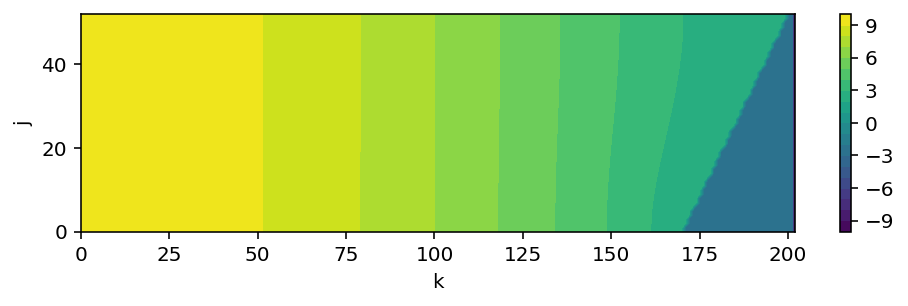

In [301]:
plt.figure(figsize=(8,2))
plt.contourf(topo, levels=20)
plt.colorbar()
plt.axis('tight')
plt.xlabel('k')
plt.ylabel('j')
plt.show()

In [302]:
topo[20:30, 90:100] = 0.

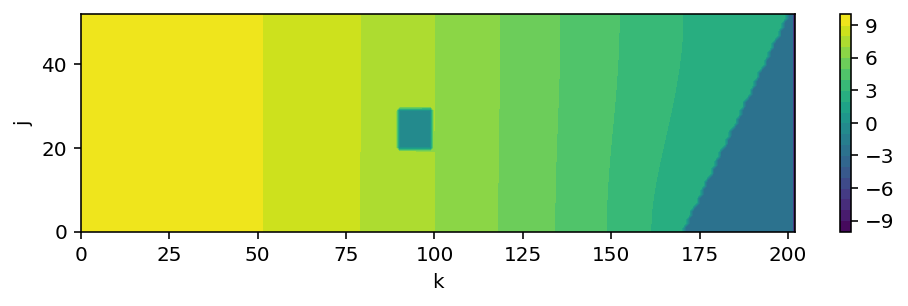

In [303]:
plt.figure(figsize=(8,2))
plt.contourf(topo, levels=20)
plt.colorbar()
plt.axis('tight')
plt.xlabel('k')
plt.ylabel('j')
plt.show()

In [294]:
np.savetxt('src/OMB_Ex9/topo2.dat', topo)

Plane waves are waves whose wavefronts (crests and troughs) are straight and
parallel to each other. Propagation occurs in a direction normal to wavefronts and
can be described by means of a phase velocity vector. Such plane waves are generated at the western open boundary via prescription of sinusoidal sea-level oscillations (uniform along this boundary) of a period of 20 s.

In a water depth of 30 m, the forcing applied creates plane shallow-water waves
of a wavelength ($\lambda = T \sqrt{gh}$) of approximately 340 m. The amplitude of oscillations
is 20 cm. The northern and southern boundaries are open boundaries. The numerical
time step is set to Δt = 0.2 s. The total simulation time is 200 s.

### 5.3.4 Lateral Boundary Conditions

See text.

### 5.3.5 Sample Code

The folder “Exercise 9” with FORTRAN simulation code has been modified to support NetCDF files and saved as in `OMB_Ex9`.

### 5.3.6 Results

In [308]:
filename = 'src/OMB_Ex9/output.nc'
ds = xr.open_dataset(filename)
ds

<xarray.Dataset>
Dimensions:  (time: 101, x: 201, y: 51)
Coordinates:
  * time     (time) datetime64[ns] 2000-01-01 2000-01-01 ... 2000-01-01
  * x        (x) float32 12.5 22.5 32.5 42.5 ... 1.992e+03 2.002e+03 2.012e+03
  * y        (y) float32 12.5 22.5 32.5 42.5 52.5 ... 482.5 492.5 502.5 512.5
Data variables:
    h        (time, x, y) float32 ...
    eta      (time, x, y) float32 ...
    u        (time, x, y) float32 ...
    v        (time, x, y) float32 ...

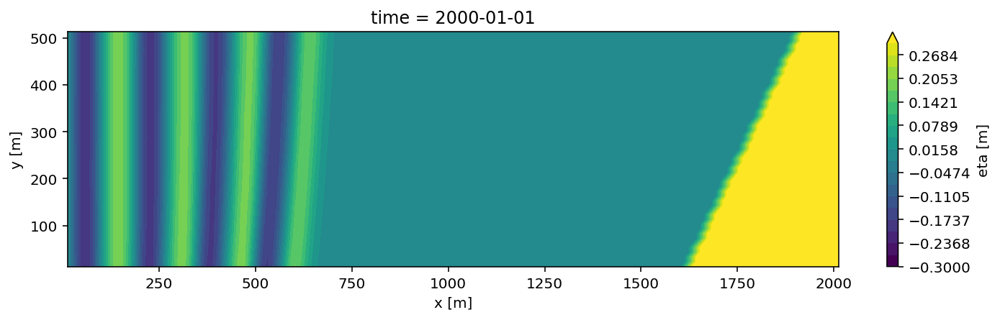

In [309]:
plt.figure(figsize=(12, 3))
ds.eta[20].plot.contourf(x='x', levels=20, vmin=-0.3, vmax=0.3)

In [310]:
def animate(filename):
    
    ds = xr.open_dataset(filename)
      
    fig, ax = plt.subplots(figsize=(12, 3))
    
    ds.eta[0].plot.contourf(ax=ax, x='x', levels=20, vmin=-0.3, vmax=0.3)
    
    def update(frame):        
        ds.eta[frame].plot.contourf(ax=ax, x='x', levels=20, vmin=-0.3, vmax=0.3,
                                add_colorbar=False)

    anim = FuncAnimation(fig, update, 
                         frames=len(ds.time)
                        )

    plt.close()
    
    return anim

In [311]:
animate(filename)

--- 
## Problem 10

Complete OMB 5.3.7 Additional Exercise for the Reader. Repeat Exercise 9 with forcing periods of 10 and 40 s. Optionally, trying running this exercise with a modified bathymetry.

---